**Table of contents**<a id='toc0_'></a>    
- [<b>Load Dataset</b>](#toc1_)    
    - [Load Config Data](#toc1_1_1_)    
    - [Load Dataset](#toc1_1_2_)    
- [<b> Exploratory Data Analysis</b>](#toc2_)    
  - [Profile Report](#toc2_1_)    
  - [Describe Data](#toc2_2_)    
  - [<b> 1. Histogram</b>](#toc2_3_)    
  - [<b>2. Kernel Density Plot</b>](#toc2_4_)    
  - [<b>3. Boxplot of Categoric features</b>](#toc2_5_)    
  - [<b>4.Segment Categorical features by the target classes</b>](#toc2_6_)    
  - [<b>5. Barplot of Categoric Features</b>](#toc2_7_)    
  - [<b>6. Group numeric features by categorical features</b>](#toc2_8_)    
  - [<b>7. Heatmap Correlation</b>](#toc2_9_)    
- [<b> Feature Selection </b>](#toc3_)    
  - [<b>1. Categorical vs Categorical (Binary Classification)</b>](#toc3_1_)    
    - [<b>Chi-Squared Test</b>](#toc3_1_1_)    
  - [<b>2. Numeric vs Categoric (Binary Classification)</b>](#toc3_2_)    
    - [<b>Normality Test: Shapiro-Wilk Test</b>](#toc3_2_1_)    
    - [<b>Normality Test: Probability Plot</b>](#toc3_2_2_)    
    - [<b>Equal Variance Test: Levene Test</b>](#toc3_2_3_)    
    - [**Welch T-Test**](#toc3_2_4_)    
  - [<b>3. Numeric vs Numeric (Multicollinearity)</b>](#toc3_3_)    
  - [<b>4. Lasso Method</b>](#toc3_4_)    
  - [<b>5. XGBoost Method</b>](#toc3_5_)    
  - [<b>6. Random Forest</b>](#toc3_6_)    
- [<b>Handling Imbalance Data</b>](#toc4_)    
  - [<b>Balancing</b>](#toc4_1_)    
  - [<b> Selected Features</b>](#toc4_2_)    
  - [Check Map Correlations using PPS](#toc4_3_)    
  - [Handling Outliers data](#toc4_4_)    
  - [Pairplot](#toc4_5_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

In [ ]:
## Load Configuration File

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import src.util as util
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler, SMOTENC
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LassoCV
from xgboost import XGBClassifier

import warnings

warnings.filterwarnings('ignore')


In [ ]:
import klib
from ydata_profiling import ProfileReport, compare


In [ ]:
sns.set_style('darkgrid')
sns.set(rc = {'axes.facecolor': '#FBFBFB', 'figure.facecolor': '#FBFBFB'})

class clr:
    start = '\033[93m'+'\033[1m'
    bold = '\033[1m'
    underline = '\033[4m'
    color = '\033[93m'
    end = '\033[0m'

# <a id='toc1_'></a>[<b>Load Dataset</b>](#toc0_)

In [4]:
def load_dataset(config_data: dict) -> pd.DataFrame:
    # Load set of data
    x_train = util.pickle_load(config_data["train_set_path"][0])
    y_train = util.pickle_load(config_data["train_set_path"][1])

    x_valid = util.pickle_load(config_data["valid_set_path"][0])
    y_valid = util.pickle_load(config_data["valid_set_path"][1])

    x_test = util.pickle_load(config_data["test_set_path"][0])
    y_test = util.pickle_load(config_data["test_set_path"][1])

    # concatenate x and y each set
    train_set = pd.concat([x_train, y_train], axis = 1)
    valid_set = pd.concat([x_valid, y_valid], axis = 1)
    test_set = pd.concat([x_test, y_test], axis = 1)

    # return 3 set of data
    return train_set, valid_set, test_set

### <a id='toc1_1_1_'></a>[Load Config Data](#toc0_)

In [379]:
config_data = util.load_config()

### <a id='toc1_1_2_'></a>[Load Dataset](#toc0_)

In [67]:
train_set, valid_set, test_set = load_dataset(config_data)

# <a id='toc2_'></a>[<b> Exploratory Data Analysis</b>](#toc0_)

-----

## <a id='toc2_1_'></a>[Profile Report](#toc0_)

In [7]:
train_set_report = ProfileReport(train_set, progress_bar=False, title="train_set", explorative=True, sample=None)

fraud_train_set = train_set[train_set['fraud_reported']=='Y']
fraud_report = ProfileReport(fraud_train_set, title="Fraud")

unfraud_train_set = train_set[train_set['fraud_reported']=='N']
unfraud_report = ProfileReport(unfraud_train_set, title="Unfraud")

In [10]:
train_set_report

## <a id='toc2_2_'></a>[Describe Data](#toc0_)

In [85]:
train_set.describe().style.background_gradient(cmap='YlOrBr')

,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
count,800.000000,800.000000,800.000000,800.000000,800.000000,800.000000,800.000000,800.000000,800.000000,800.000000,800.000000,800.000000
mean,204.001250,39.016250,544664.695000,1257.717500,502376.073750,24541.625000,-26499.875000,11.568750,52173.800000,7373.562500,7324.225000,37476.012500
std,114.308954,9.111243,257844.798758,241.703239,72297.680525,27683.000479,27953.002977,6.903974,27072.205473,4947.459386,4890.629967,19309.207955
min,0.000000,20.000000,100804.000000,433.000000,430104.000000,0.000000,-111100.000000,0.000000,1920.000000,0.000000,0.000000,1440.000000
25%,115.750000,32.000000,330473.000000,1097.000000,448692.250000,0.000000,-51025.000000,6.000000,39950.000000,4065.000000,4270.000000,28980.000000
50%,202.000000,38.500000,533940.500000,1265.000000,466704.500000,0.000000,-21200.000000,12.000000,57700.000000,6675.000000,6700.000000,41760.000000
75%,276.000000,44.250000,757918.000000,1406.000000,603417.500000,50400.000000,0.000000,17.000000,70425.000000,11330.000000,10940.000000,50762.500000
max,479.000000,64.000000,999435.000000,2047.000000,620962.000000,100500.000000,0.000000,23.000000,114920.000000,21450.000000,23670.000000,79560.000000


In [88]:
train_set.describe(include='object')

,policy_deductable,umbrella_limit,number_of_vehicles_involved,bodily_injuries,witnesses,auto_year,policy_state,policy_csl,insured_sex,insured_hobbies,...,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,property_damage,police_report_available,auto_make,auto_model,fraud_reported
count,800,800,800,800,800,800,800,800,800,800,...,800,800,800,800,800,800,800,800,800,800
unique,3,11,4,3,4,21,3,3,2,20,...,4,4,5,7,7,3,3,14,39,2
top,500,0,1,0,1,2003,OH,250/500,FEMALE,reading,...,Rear Collision,Minor Damage,Police,NY,Springfield,UNKNOWN,NO,Suburu,Wrangler,N
freq,277,639,466,276,208,48,282,286,426,54,...,232,281,235,205,127,286,278,70,33,602


## <a id='toc2_3_'></a>[<b> 1. Histogram</b>](#toc0_)

What we look out for:
- Potential <b>outliers</b>
- <b>Numeric features that should be categorical (indicator)</b> features. For example, if there are only two possible values like 0 and 1.
- Boundaries that do not make sense, such as <b>percentage value more than 100</b>.

Using the `histplot` from seaborn with `kind = kde`, and separate the histogram into two category of target. <br>
Histogram are using to approach the miscellaneous thing we seek before, while `kde` are using to understand the distribution of the numeric features.

<Figure size 1000x1000 with 0 Axes>

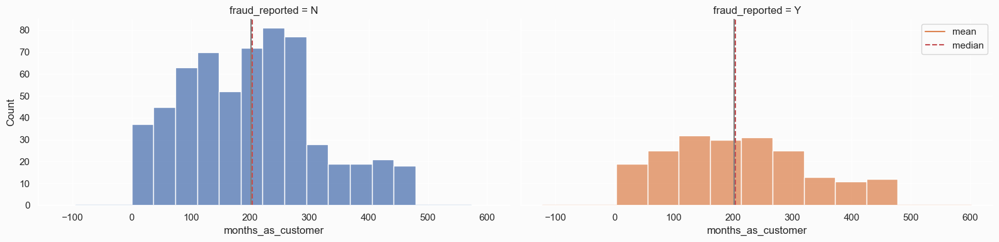

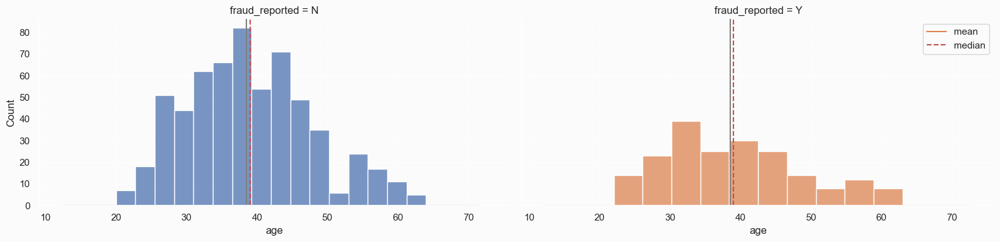

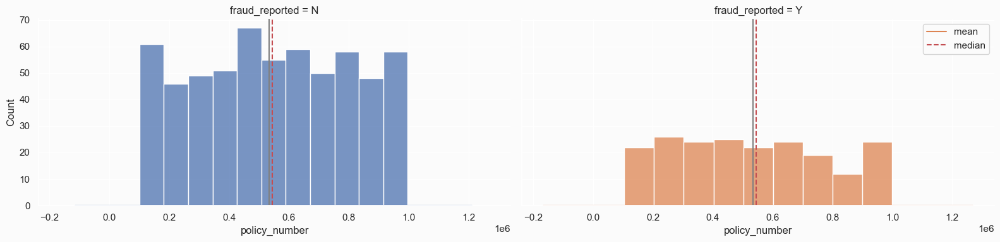

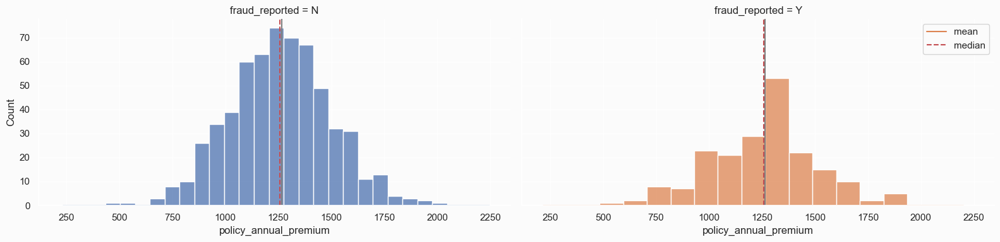

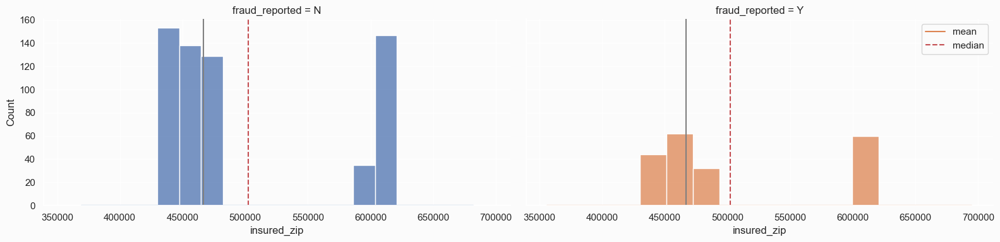

...

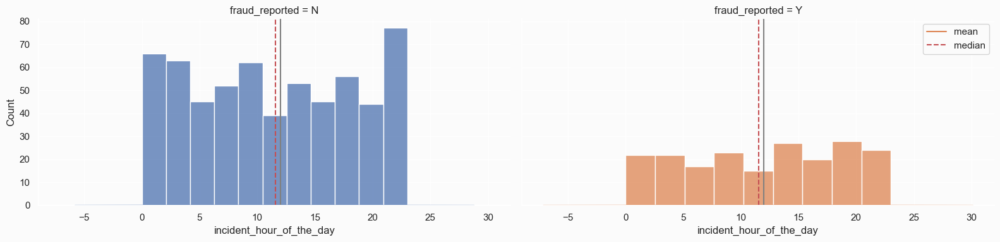

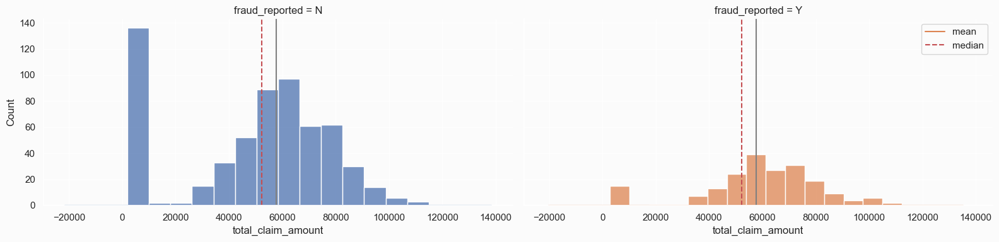

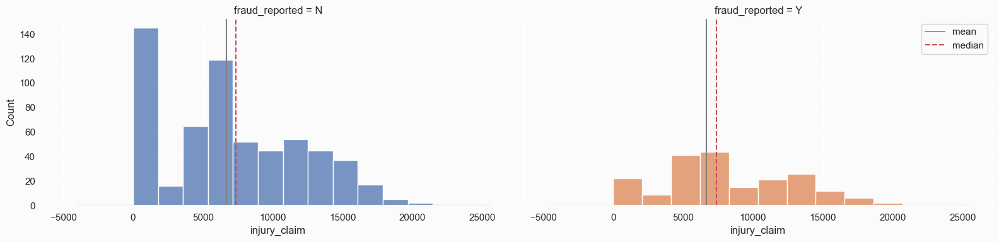

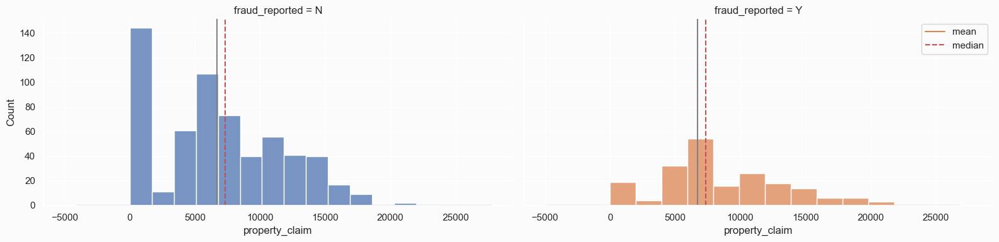

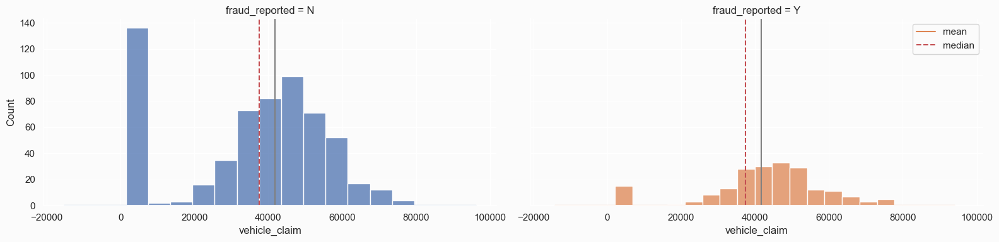

In [35]:
list_num_col = []

for col in train_set.columns:
    if (train_set[col].dtype =='int32'):
        list_num_col.append(col)

plt.figure(figsize=(10,10))
count = 0

for i in range(len(list_num_col) // 2):
    for j in range(2):

        if count >= len(list_num_col):
            break

        g = sns.FacetGrid(data=train_set, col='fraud_reported', hue='fraud_reported', height=4, aspect= 2)
        g.map_dataframe(sns.histplot, x=list_num_col[count])
        g.map_dataframe(sns.kdeplot, x=list_num_col[count])
        
        g.refline(x=train_set[list_num_col[count]].mean(), color='r')
        g.refline(x=train_set[list_num_col[count]].median(), linestyle='-')

        plt.legend(['mean', 'median'])

        count += 1

plt.tight_layout()
plt.show()

- <b>`insured_zip`</b> are prone into two group of <b>>500.000</b> and <b><600.000</b>
- <b>`capital_gains`</b> is highly <b>left-skewed</b> distributed since it has much zero values (0)

## <a id='toc2_4_'></a>[<b>2. Kernel Density Plot</b>](#toc0_)

KDE plot using `klib.dist_plot` to give better distribution comprehension of numeric features, given <b>mean, median, and standard deviation</b>

<Axes: xlabel='vehicle_claim', ylabel='Density'>

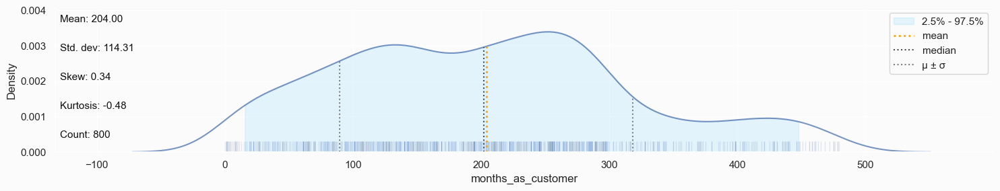

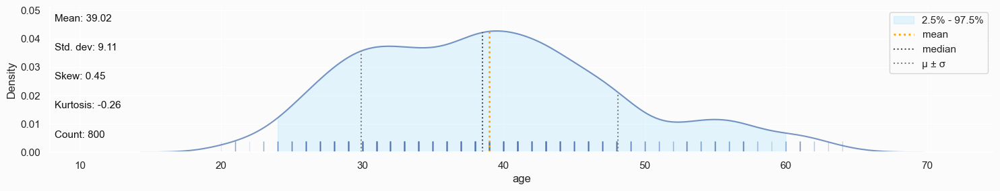

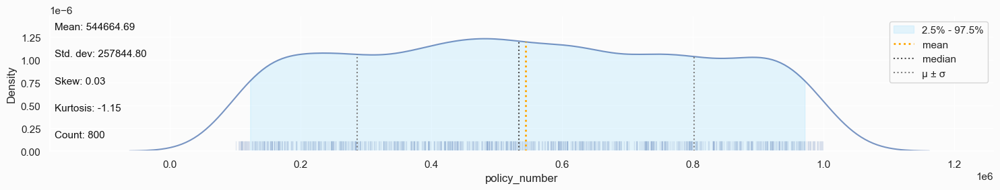

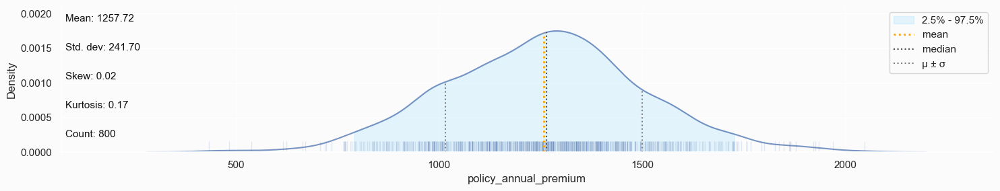

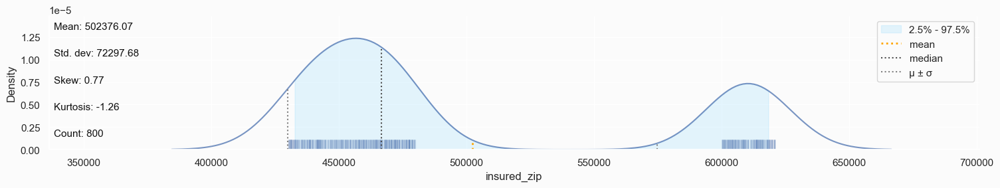

...

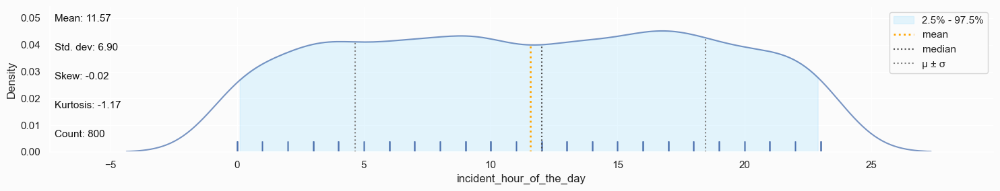

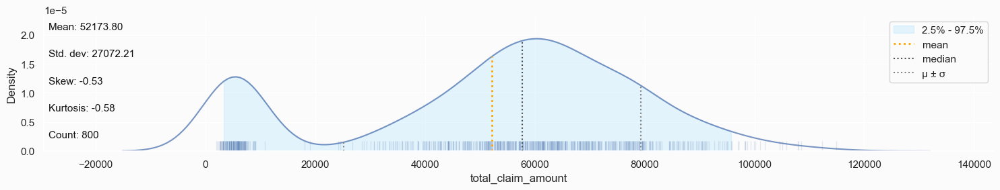

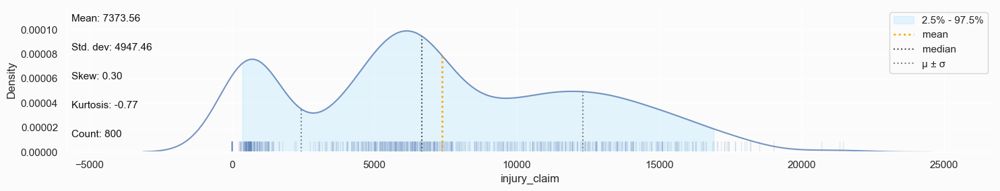

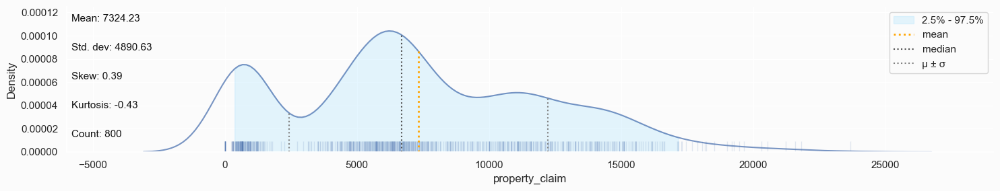

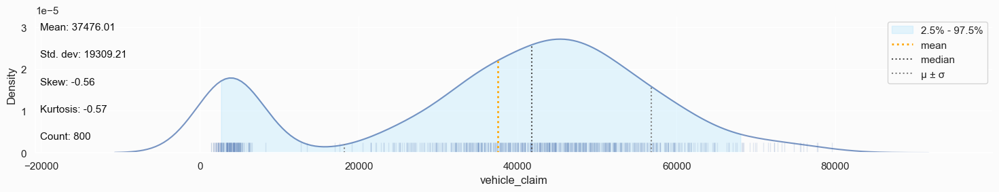

In [30]:
klib.dist_plot(train_set)

There are several features in the dataset that exhibit a **`bimodal distribution`**, meaning they have two distinct peaks or modes. These features are strongly **correlated with the amount of money**. Consequently, the **occurrence of a value of 0 in these features creates the bimodal distribution**. The correlation with the amount of money suggests that these features play a significant role in determining the monetary values observed in the dataset.

## <a id='toc2_5_'></a>[<b>3. Boxplot of Categoric features</b>](#toc0_)

**Segment the target by numeric features**

<center>
<img src='https://th.bing.com/th/id/OIP.0MPDTLn8KoLApoFvI0P2vQHaDt?pid=ImgDet&rs=1'>
</center>

We will use **`sns.boxplot`** which displays the five-number summary of a numeric feature. The five numbers are **minimum**, **first quartile (Q1 or 25% mark)**,**median (Q2)**, **third quartile (Q3 or 75% mark)**, and **maximum**

Here, we will separate the data by the target feature and observe how the numeric features are distributed among those which **fraud (target = 1)** and those which **non-fraud (target = 0)**.



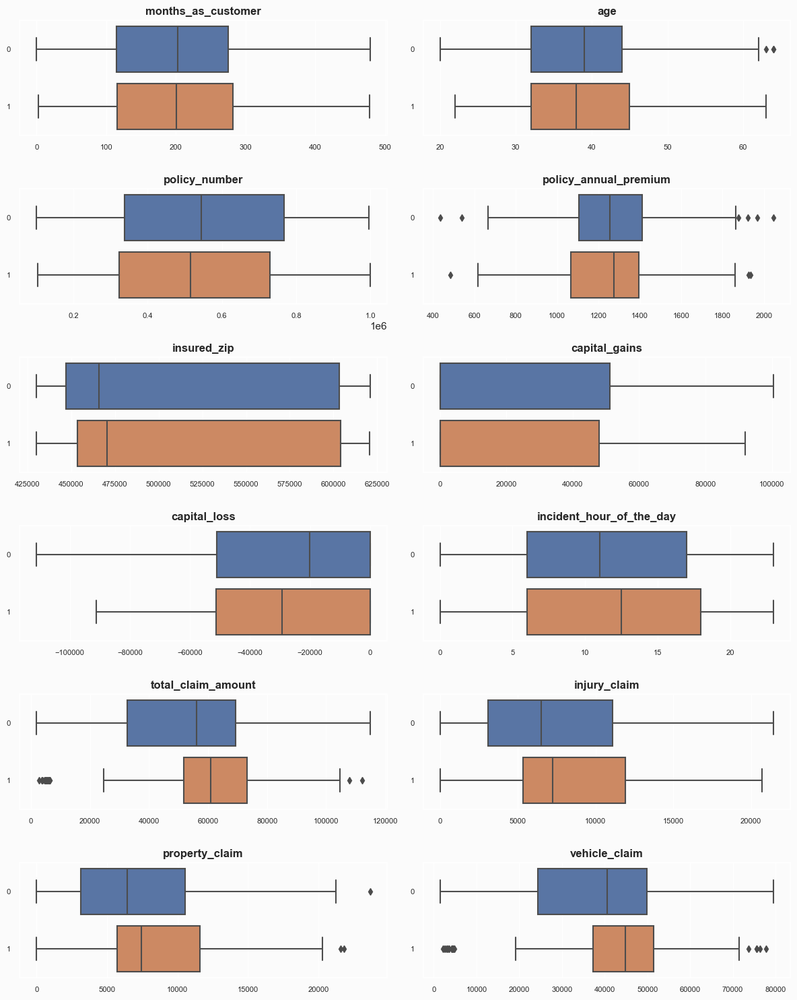

In [ ]:
fig, axs = plt.subplots(len(list_num_col) // 2, 2, figsize=(12,15))
count = 0

train_set_box = train_set.copy()
train_set_box.fraud_reported = train_set_box.fraud_reported.map(dict(Y=1,N=0))


for i in range(len(list_num_col) // 2):
    for j in range(2):

        if count >= len(list_num_col):
            break

        sns.boxplot(data = train_set_box, x=list_num_col[count], y='fraud_reported', ax=axs[i, j], orient='h')

        axs[i, j].tick_params(axis='x', labelsize=8)
        axs[i, j].tick_params(axis='y', labelsize=8)

        axs[i, j].set_xlabel('')
        axs[i, j].set_ylabel('')
        axs[i, j].set_title(list_num_col[count], fontweight='bold')
        # axs[i, j].legend(loc='upper right')

        count += 1

# fig.legend(['N','Y'], loc='upper right', title='fraud_reported')

plt.tight_layout()
plt.show()

We can see that **`month_as_customers, age, insured_zip, capital_gains, capital_loss, incident_hours_of_the_day`** <br>
are almost **equally distributed** among those which non-fraud (target 0) and those which fraud (target 1). <br>
This means that training_hours **might not be a good predictor** for the target. 

However, we see that when it comes to **`policy_annual_premium, total_claim_amount, injury_claim, property_claim, vehicle_claim`**,<br> 
a bigger proportion of those who stayed are tending towards more years of experience and these could be **good predictors**.

## <a id='toc2_6_'></a>[<b>4.Segment Categorical features by the target classes</b>](#toc0_)

Now that we have seen how the target changes with numeric features, we will do the same for categorical features.

**`pd.crosstab(col1, col2)`** function builds a *cross-tabulation table* that shows the **relationship between two categorical features**. The table shows the **frequency** by which groups of data from the two features appear. You can include the parameter `normalize='index'` to show the percentages

Here, loop through 4 categorical columns (those with less than 5 unique classes).

In [101]:
for col in list_cat_col:
    if train_set[col].nunique() <= 4:
        display(pd.crosstab(train_set.fraud_reported, train_set[col], normalize='index').style.background_gradient(cmap='YlOrBr'))

policy_deductable,1000,2000,500
fraud_reported,,,
N,0.342193,0.312292,0.345515
Y,0.313131,0.338384,0.348485


number_of_vehicles_involved,1,2,3,4
fraud_reported,,,,
N,0.594684,0.026578,0.350498,0.028239
Y,0.545455,0.035354,0.378788,0.040404


bodily_injuries,0,1,2
fraud_reported,,,
N,0.353821,0.323920,0.322259
Y,0.318182,0.287879,0.393939


witnesses,0,1,2,3
fraud_reported,,,,
N,0.262458,0.260797,0.237542,0.239203
Y,0.191919,0.257576,0.308081,0.242424


policy_state,IL,IN,OH
fraud_reported,,,
N,0.335548,0.317276,0.347176
Y,0.318182,0.313131,0.368687


policy_csl,100/300,250/500,500/1000
fraud_reported,,,
N,0.335548,0.358804,0.305648
Y,0.363636,0.353535,0.282828


insured_sex,FEMALE,MALE
fraud_reported,,
N,0.533223,0.466777
Y,0.530303,0.469697


incident_type,Multi-vehicle Collision,Parked Car,Single Vehicle Collision,Vehicle Theft
fraud_reported,,,,
N,0.405316,0.114618,0.367110,0.112957
Y,0.454545,0.040404,0.469697,0.035354


collision_type,Front Collision,Rear Collision,Side Collision,UNKNOWN
fraud_reported,,,,
N,0.244186,0.270764,0.257475,0.227575
Y,0.287879,0.348485,0.287879,0.075758


incident_severity,Major Damage,Minor Damage,Total Loss,Trivial Damage
fraud_reported,,,,
N,0.146179,0.420266,0.318937,0.114618
Y,0.661616,0.141414,0.166667,0.030303


property_damage,NO,UNKNOWN,YES
fraud_reported,,,
N,0.378738,0.338870,0.282392
Y,0.272727,0.414141,0.313131


police_report_available,NO,UNKNOWN,YES
fraud_reported,,,
N,0.340532,0.330565,0.328904
Y,0.368687,0.348485,0.282828


fraud_reported,N,Y
fraud_reported,,
N,1.000000,0.000000
Y,0.000000,1.000000


These tables show few categoric features do not have significant difference between target of **fraud (Y)** and **non-fraud (N)** such as:<br>
**`policy_deductable, policy_state, police_report_available, insured_sex, policy_csl, policy_state`**

## <a id='toc2_7_'></a>[<b>5. Barplot of Categoric Features</b>](#toc0_)

Here, we gonna visualize the **pd.crosstab** above into `countplot`

We can plot the categorical relationships above to get a better feel of the interactions. <br>
We will create count plots of the data using **Seaborn’s `catplot()`** function and provide **`kind=count`** as a parameter

Notice the parameter **`sharey=False`** in catplot which disassociates the y-scales for each target class so that we can **better view and compare the relationships**.

<Figure size 1200x300 with 0 Axes>

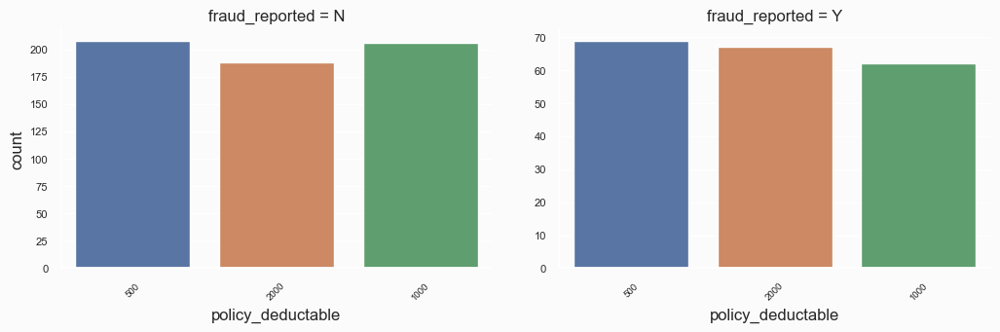

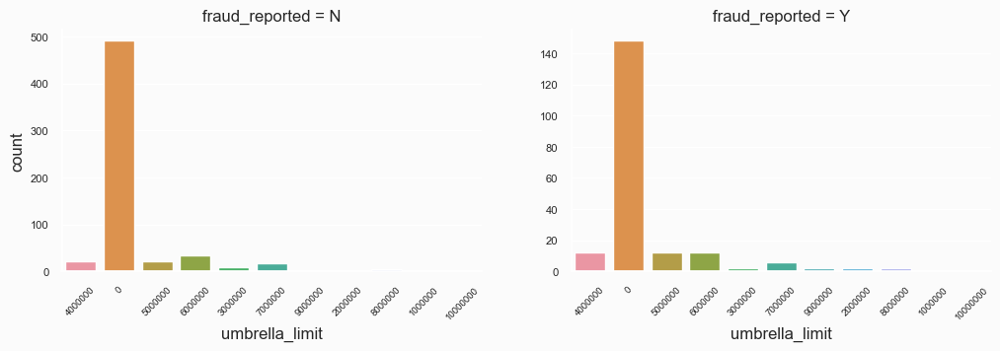

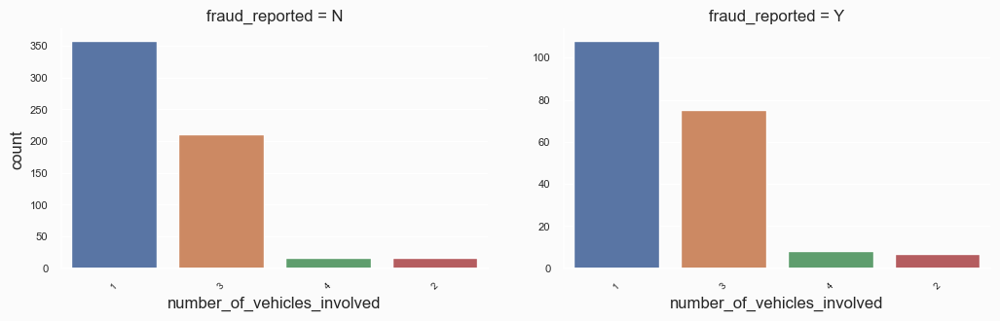

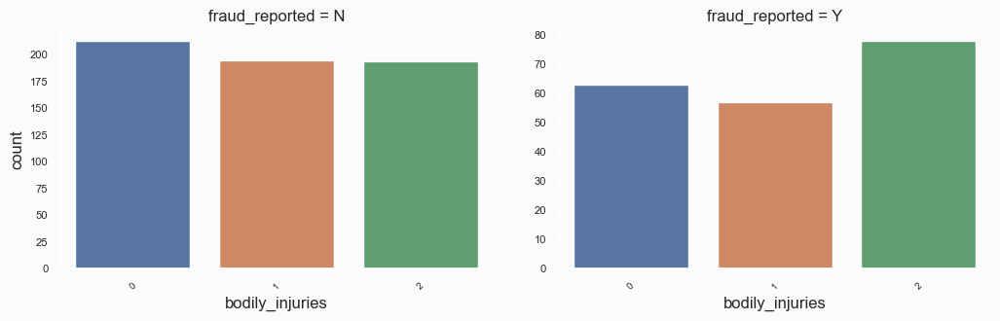

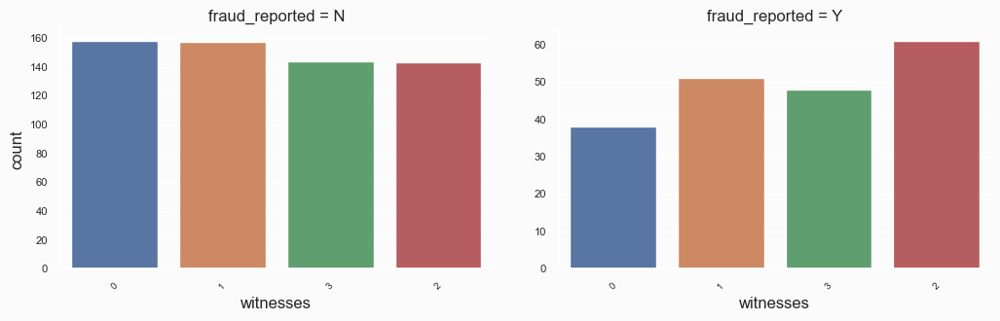

...

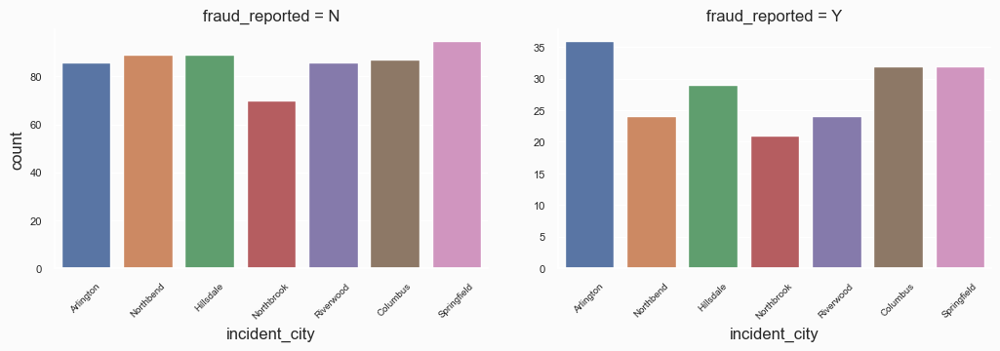

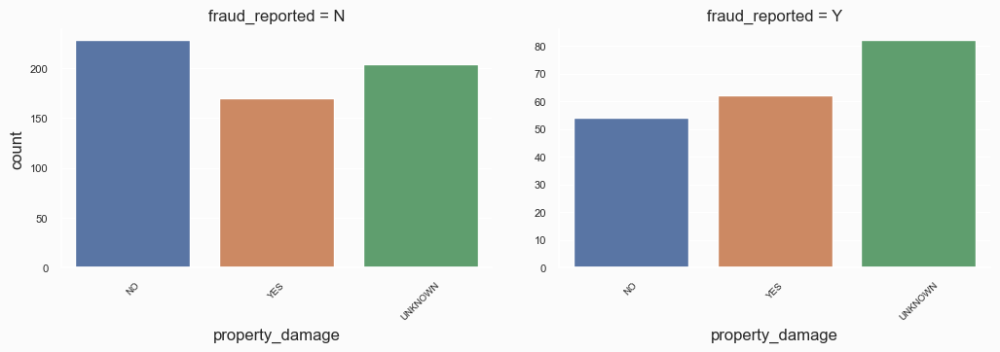

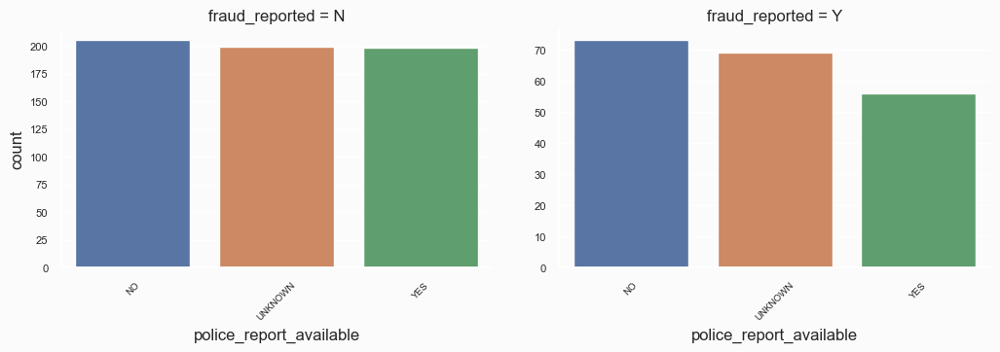

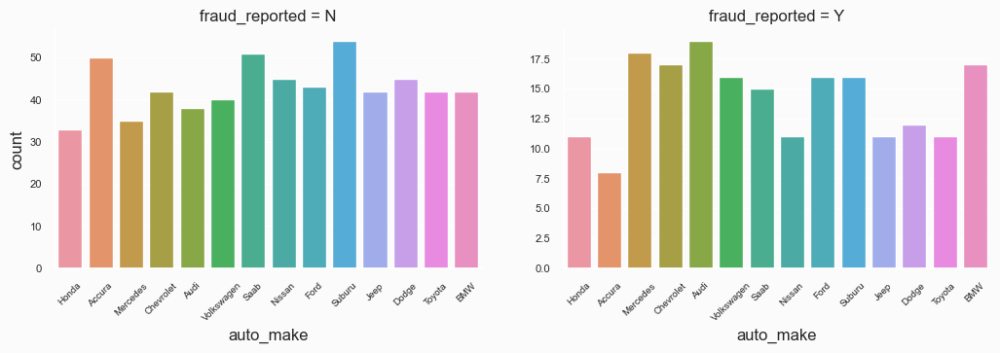

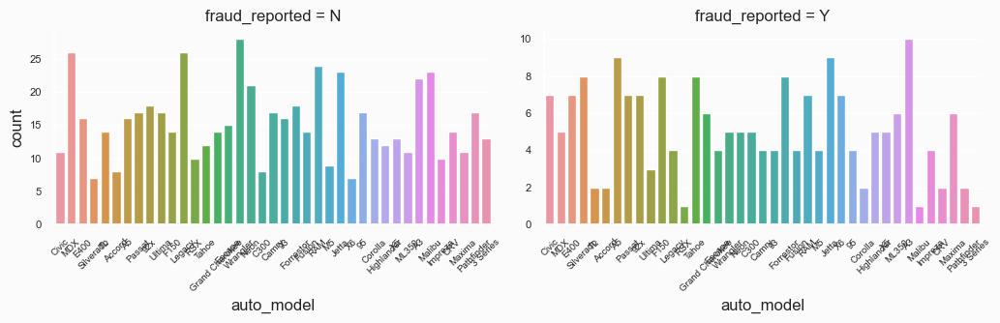

In [ ]:
list_cat_col = []

for col in train_set.columns:
    if (train_set[col].dtype =='object'):
        list_cat_col.append(col)

plt.figure(figsize=(12, 3))
count = 0

for i in range(len(list_cat_col) // 2):
    for j in range(2):

        if count >= len(list_cat_col):
            break

        c = sns.catplot(data = train_set, x = list_cat_col[count], col='fraud_reported', kind='count', 
                        sharey=False, height=3.5, aspect=1.5)

        c.tick_params(axis='x', labelsize=8)
        c.tick_params(axis='y', labelsize=8)
        c.set_xticklabels(rotation=45, fontsize=7)

        count += 1

plt.tight_layout()
plt.show()

**`property_damage`, `bodily_injuries`, `witnesses`, `insured_hobbies`, `collision_type`, `incident_severity`, `authorities_contacted`, <br>
`incident_state`, `incident_city`, `property_damage`, `auto_make`, `auto_model`**

These features show a **significant relationship between target (fraud_reported)**. <br>
Visibly, they **exhibit distinct patterns that are different from each other**. These patterns in the features are strongly associated with the occurrence of fraud, making them crucial indicators for predicting fraudulent activities.

## <a id='toc2_8_'></a>[<b>6. Group numeric features by categorical features</b>](#toc0_)

We will use the **`pd.groupby()`** function to group our data into categories and observe how the numeric features are distributed by calculating a metric such as 

**`mean, median, and standard deviation`** across the classes.

In [117]:
for col in list_cat_col:
    if train_set[col].nunique() <= 5:
        display(train_set.groupby(col)[list_num_col].mean().style.background_gradient(cmap='Blues'))

,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
policy_deductable,,,,,,,,,,,,
1000,195.858209,38.477612,535343.317164,1272.660448,496124.138060,22939.552239,-26857.089552,11.768657,50640.037313,7035.261194,6780.634328,36824.141791
2000,208.486275,39.364706,549448.584314,1255.117647,504233.329412,27021.568627,-27859.607843,12.266667,53835.098039,7661.372549,7850.980392,38322.745098
500,207.750903,39.216606,549279.270758,1245.653430,506715.129964,23808.664260,-24902.527076,10.732852,52128.375451,7435.920578,7365.234657,37327.220217


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
number_of_vehicles_involved,,,,,,,,,,,,
1,200.390558,38.759657,541311.143777,1271.030043,502237.195279,23759.442060,-26340.557940,10.652361,45209.763948,6272.982833,6319.935622,32616.845494
2,221.130435,38.782609,578097.782609,1204.652174,485430.478261,18113.043478,-28730.434783,14.434783,66323.913043,9226.956522,9990.869565,47106.086957
3,207.930070,39.416084,549069.884615,1241.636364,502304.027972,25420.629371,-27294.405594,12.884615,61667.902098,8947.202797,8581.188811,44139.510490
4,210.600000,39.440000,526021.080000,1242.360000,521378.920000,34980.000000,-18328.000000,10.960000,60352.800000,8180.800000,9211.200000,42960.800000


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
bodily_injuries,,,,,,,,,,,,
0,205.974638,39.188406,539556.586957,1253.282609,502198.699275,22382.246377,-25657.246377,11.818841,50703.079710,7243.804348,7127.826087,36331.449275
1,196.924603,38.496032,558315.833333,1258.642857,499857.976190,25463.888889,-25335.317460,11.420635,49588.174603,6734.285714,6788.293651,36065.595238
2,208.555147,39.323529,537200.544118,1261.360294,504889.000000,25878.308824,-28433.823529,11.452206,56061.654412,8097.500000,8020.036765,39944.117647


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
witnesses,,,,,,,,,,,,
0,196.923469,38.408163,545161.153061,1256.734694,500489.653061,28283.163265,-24794.897959,11.913265,53745.204082,7886.173469,7146.479592,38712.551020
1,205.221154,39.197115,531282.375000,1281.956731,507598.649038,22992.788462,-25381.730769,10.721154,50043.701923,6951.778846,7063.990385,36027.932692
2,206.328431,39.382353,561203.838235,1242.803922,499119.941176,20677.941176,-29674.019608,11.892157,53760.392157,7572.892157,7516.862745,38670.637255
3,207.432292,39.052083,541082.567708,1248.307292,502103.645833,26505.208333,-26079.166667,11.791667,51191.510417,7095.416667,7582.916667,36513.177083


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
policy_state,,,,,,,,,,,,
IL,210.124528,39.833962,509861.822642,1259.188679,501032.660377,22318.867925,-24697.735849,11.309434,53207.471698,7778.075472,7523.207547,37906.188679
IN,198.640316,38.142292,562086.628458,1257.573123,503583.304348,24598.418972,-29609.486166,11.636364,52009.407115,7376.956522,7168.181818,37464.268775
OH,203.056738,39.031915,561739.205674,1256.464539,502555.418440,26579.432624,-25403.546099,11.751773,51349.929078,6990.390071,7277.234043,37082.304965


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
policy_csl,,,,,,,,,,,,
100/300,208.806569,39.160584,515748.222628,1254.656934,499822.047445,23759.854015,-24734.306569,11.525547,55290.985401,7959.562044,7771.824818,39559.598540
250/500,204.108392,39.223776,568279.489510,1261.888112,503652.867133,24990.909091,-27741.258741,11.741259,50096.748252,7102.132867,6973.391608,36021.223776
500/1000,198.387500,38.604167,549536.704167,1256.241667,503770.408333,24898.750000,-27036.250000,11.412500,51090.166667,7028.000000,7231.291667,36830.875000


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
insured_sex,,,,,,,,,,,,
FEMALE,197.518779,38.368545,543501.328638,1243.659624,503228.349765,24304.460094,-25469.953052,11.453052,52819.647887,7450.516432,7367.347418,38001.784038
MALE,211.385027,39.754011,545989.812834,1273.729947,501405.299465,24811.764706,-27672.994652,11.700535,51438.155080,7285.909091,7275.106952,36877.139037


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
incident_type,,,,,,,,,,,,
Multi-vehicle Collision,209.038922,39.374251,549343.601796,1239.143713,502569.838323,25632.934132,-26722.155689,12.847305,61890.089820,8909.101796,8725.419162,44255.568862
Parked Car,197.480519,38.662338,529245.272727,1232.246753,505863.194805,23575.324675,-27279.220779,7.779221,5393.766234,741.298701,783.766234,3868.701299
Single Vehicle Collision,202.751592,39.019108,531549.818471,1283.009554,499112.617834,23793.630573,-26700.636943,12.015924,64472.738854,8946.592357,9007.452229,46518.694268
Vehicle Theft,193.493333,37.773333,594566.186667,1260.693333,511596.066667,23805.333333,-23869.333333,7.893333,5439.866667,758.666667,752.000000,3929.200000


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
collision_type,,,,,,,,,,,,
Front Collision,218.544118,40.446078,547378.686275,1240.269608,503561.352941,24624.019608,-30082.352941,12.166667,64729.607843,9222.598039,9048.284314,46458.725490
Rear Collision,200.637931,38.599138,542894.642241,1264.275862,499025.465517,24284.051724,-25888.362069,12.000000,61834.439655,8946.379310,8687.025862,44201.034483
Side Collision,199.773585,38.665094,531936.778302,1275.528302,500373.886792,25355.660377,-24369.339623,13.198113,63043.867925,8622.169811,8874.481132,45547.216981
UNKNOWN,195.513158,38.223684,561475.986842,1246.282895,508691.914474,23688.815789,-25596.710526,7.835526,5416.513158,749.868421,768.092105,3898.552632


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
incident_severity,,,,,,,,,,,,
Major Damage,204.378995,39.251142,527498.260274,1256.958904,504034.470320,23776.255708,-25291.324201,12.712329,64415.342466,8930.913242,9444.292237,46040.136986
Minor Damage,210.220641,39.327402,560776.772242,1259.857651,504515.654804,26212.099644,-25808.185053,10.879004,47361.957295,6808.291815,6587.686833,33965.978648
Total Loss,201.537778,38.866667,538580.822222,1263.311111,496258.773333,24406.666667,-29444.000000,12.560000,61874.533333,8785.022222,8378.622222,44710.888889
Trivial Damage,186.986667,37.613333,552675.720000,1235.133333,507869.160000,20922.666667,-23788.000000,7.840000,5354.666667,709.600000,730.000000,3915.066667


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
authorities_contacted,,,,,,,,,,,,
Ambulance,198.051948,38.629870,505522.396104,1275.740260,502445.266234,25898.701299,-30062.987013,12.097403,61119.220779,8457.727273,8847.012987,43814.480519
Fire,203.849711,38.809249,581953.838150,1273.797688,503354.786127,23210.404624,-25024.855491,12.641618,63212.254335,9080.809249,8430.231214,45701.213873
Other,207.641026,39.410256,524575.782051,1256.237179,501695.057692,23464.743590,-27939.743590,12.371795,64467.115385,9159.551282,9140.000000,46167.564103
Police,209.008511,39.451064,550586.804255,1237.114894,500778.919149,23982.553191,-24559.574468,11.387234,46381.872340,6535.021277,6596.000000,33250.851064
UNKNOWN,194.219512,38.182927,560750.878049,1251.804878,506054.085366,28452.439024,-25741.463415,7.304878,5296.951220,740.975610,763.536585,3792.439024


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
property_damage,,,,,,,,,,,,
NO,202.251773,38.886525,555157.131206,1254.641844,507594.000000,26750.354610,-27454.255319,11.202128,50789.184397,7332.056738,7169.255319,36287.872340
UNKNOWN,206.353147,39.332168,535786.458042,1236.657343,494373.639860,22054.895105,-26354.895105,11.209790,51389.370629,7166.783217,7224.615385,36997.972028
YES,203.228448,38.784483,542855.681034,1287.418103,505898.663793,24922.413793,-25518.534483,12.456897,54823.836207,7678.922414,7635.387931,39509.525862


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
police_report_available,,,,,,,,,,,,
NO,210.035971,39.392086,538538.967626,1246.226619,498886.280576,24333.453237,-25113.309353,11.406475,49802.266187,6921.582734,7058.129496,35822.553957
UNKNOWN,199.488806,38.750000,532770.376866,1265.477612,506396.839552,25865.671642,-25607.835821,11.186567,54095.074627,7689.514925,7577.947761,38827.611940
YES,202.157480,38.885827,563919.141732,1262.106299,501953.228346,23372.440945,-28958.661417,12.149606,52742.244094,7534.881890,7347.755906,37859.606299


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital_gains,capital_loss,incident_hour_of_the_day,total_claim_amount,injury_claim,property_claim,vehicle_claim
fraud_reported,,,,,,,,,,,,
N,202.604651,38.936877,550479.579734,1258.689369,501545.184385,24822.093023,-26235.215947,11.443522,49572.906977,7102.923588,6910.099668,35559.883721
Y,208.247475,39.257576,526985.095960,1254.762626,504902.313131,23688.888889,-27304.545455,11.949495,60081.565657,8196.414141,8583.333333,43301.818182


## <a id='toc2_9_'></a>[<b>7. Heatmap Correlation</b>](#toc0_)

<center>
<img src='https://miro.medium.com/v2/resize:fit:640/1*hbWteVlb_CzHa5xB4KFpaQ.gif'>
</center>

A correlation matrix is a table used to summarize the associations between numeric features. The same features are shown in the rows and columns, and each cell holds the correlation coefficient of two features

What to look out for:
- Strong relationship between numeric features, drop these features to reduce **redundance (collinearity)** in data.
- **Collinearity** is the state where two variables are highly correlated and contain similar information about the **variance within a given dataset.**

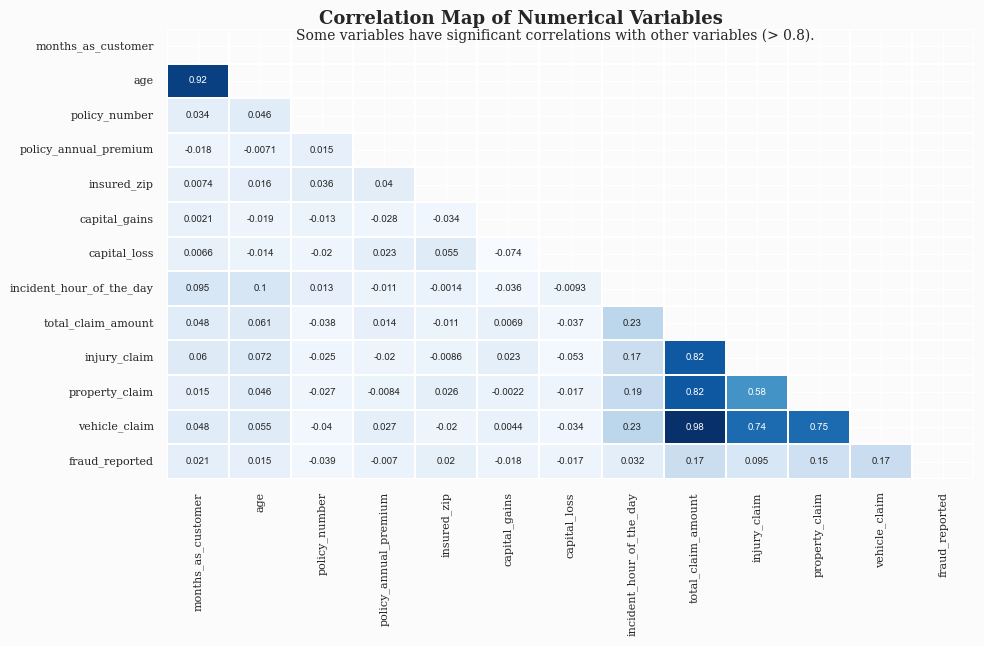

In [141]:
train_corr = train_set.copy()

train_corr.fraud_reported = train_corr.fraud_reported.map(dict(Y=1, N=0))

# -- Create Figure -- #
fig, ax = plt.subplots(figsize=(10,7))

# --- Create Correlation --- #
corr = train_corr[train_corr.select_dtypes(exclude='object').columns].corr()

# --- Create Mask --- #
mask = np.triu(np.ones_like(corr, dtype=bool))

# --- Cretea heatmap --- #
sns.heatmap(corr, annot=True, mask=mask, cmap='Blues', linewidths=0.1, cbar=False, annot_kws={"size":7})

# --- Figuration Setting --- #
yticks, ylabels = plt.yticks()
xticks, xlabels = plt.xticks()
ax.set_xticklabels(xlabels, size=8, fontfamily='serif')
ax.set_yticklabels(ylabels, size=8, fontfamily='serif')
plt.suptitle('Correlation Map of Numerical Variables', fontweight='heavy', x=0.327, y=0.96, ha='left', fontsize=13, fontfamily='serif')
plt.title('Some variables have significant correlations with other variables (> 0.8).\n', fontsize=10, x=0.16, y=0.92, fontfamily='serif', loc='left')
plt.tight_layout(rect=[0, 0.04, 1, 1.01])

# <a id='toc3_'></a>[<b> Feature Selection </b>](#toc0_)

-----

## <a id='toc3_1_'></a>[<b>1. Categorical vs Categorical (Binary Classification)</b>](#toc0_)

### <a id='toc3_1_1_'></a>[<b>Chi-Squared Test</b>](#toc0_)

**Null Hypothesis**: The two categorical variables have no relationship (independent) <br>
**Alternate Hypothesis**: There is a relationship between two categorical variables (dependannt)


> <b>H<sub>0</sub></b> : (Feature not important)<br> 
> <b>H<sub>1</sub></b> : (Feature important)

Null Hypothesis is trying to tell the probability of observing data at least as extreme as the ones we've observed is assuming the <b>all categories in features did in reality have the same frequency of fraud.</b>


In [211]:
from scipy.stats import chi2_contingency

X_cat = train_set[list_cat_col].loc[:, ~train_set[list_cat_col].columns.isin(['fraud_reported'])]
y_cat = train_set['fraud_reported']

alpha = 0.05
p_values_ = dict()

for col in X_cat.columns:

    chi2_data = pd.crosstab(X_cat[col], y_cat)

    chi2, p, dof, expected = chi2_contingency(chi2_data)

    p_values_.setdefault('column', []).append(col)
    p_values_.setdefault('p_values', []).append(p)
    p_values_.setdefault('chi2', []).append(chi2)

    if p < alpha:
        p_values_.setdefault('result', []).append('Reject Ho')        

    else:
        p_values_.setdefault('result', []).append('Failed to Reject Ho') 

chi2_data = pd.DataFrame(p_values_).set_index('column')
chi2_data

,p_values,chi2,result
column,,,
policy_deductable,7.055207e-01,0.697638,Failed to Reject Ho
umbrella_limit,2.743551e-01,12.162087,Failed to Reject Ho
number_of_vehicles_involved,5.604340e-01,2.058109,Failed to Reject Ho
bodily_injuries,1.813591e-01,3.414552,Failed to Reject Ho
witnesses,1.142818e-01,5.945707,Failed to Reject Ho
auto_year,3.724344e-01,21.426290,Failed to Reject Ho
policy_state,8.439488e-01,0.339327,Failed to Reject Ho
policy_csl,7.358715e-01,0.613400,Failed to Reject Ho
insured_sex,1.000000e+00,0.000000,Failed to Reject Ho


In [353]:
chi_score_feature = chi2_data[chi2_data['result']=='Reject Ho'].index.to_list()
chi_score_feature

['insured_hobbies',
 'incident_type',
 'collision_type',
 'incident_severity',
 'authorities_contacted',
 'incident_state',
 'property_damage']

In [213]:
from sklearn.feature_selection import chi2
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()

chi2_data_2 = train_set.copy()

for col in X_cat.columns:

    chi2_data_2[col] = label_encoder.fit_transform(chi2_data_2[col])

chi2_data_2.fraud_reported = label_encoder.fit_transform(chi2_data_2.fraud_reported)

chi_score = chi2(chi2_data_2[X_cat.columns], chi2_data_2.fraud_reported)

p_values_ = pd.Series(chi_score[1], index = chi2_data_2[X_cat.columns].columns)

In [216]:
p_values_[p_values_ < 0.05]

umbrella_limit           2.451398e-06
insured_hobbies          5.103306e-03
collision_type           1.033663e-03
incident_severity        9.759006e-21
authorities_contacted    1.920248e-04
dtype: float64

## <a id='toc3_2_'></a>[<b>2. Numeric vs Categoric (Binary Classification)</b>](#toc0_)

### <a id='toc3_2_1_'></a>[<b>Normality Test: Shapiro-Wilk Test</b>](#toc0_)

In [229]:
from statsmodels.formula.api import ols
from scipy.stats import shapiro

shapiro_ = {}

for i,col in enumerate(list_num_col):
    model = ols(f'{col} ~ fraud_reported', data=pd.concat([train_set[list_num_col], train_set['fraud_reported']], axis=1)).fit()

    shapiro_.setdefault('column', []).append(col)
    shapiro_.setdefault('shapiro', []).append(shapiro(model.resid)[1])

    if shapiro(model.resid)[1] < 0.01:
        shapiro_.setdefault('result', []).append('Reject Ho')
    else:
        shapiro_.setdefault('result', []).append('Failed to Reject Ho')

shapiro_ = pd.DataFrame(shapiro_).set_index('column')

In [230]:
shapiro_


,shapiro,result
column,,
months_as_customer,5.370890e-10,Reject Ho
age,1.068292e-09,Reject Ho
policy_number,4.490583e-14,Reject Ho
policy_annual_premium,7.273356e-01,Failed to Reject Ho
insured_zip,6.829603e-34,Reject Ho
capital_gains,2.208908e-30,Reject Ho
capital_loss,8.032668e-29,Reject Ho
incident_hour_of_the_day,9.508030e-15,Reject Ho
total_claim_amount,1.544749e-17,Reject Ho


### <a id='toc3_2_2_'></a>[<b>Normality Test: Probability Plot</b>](#toc0_)

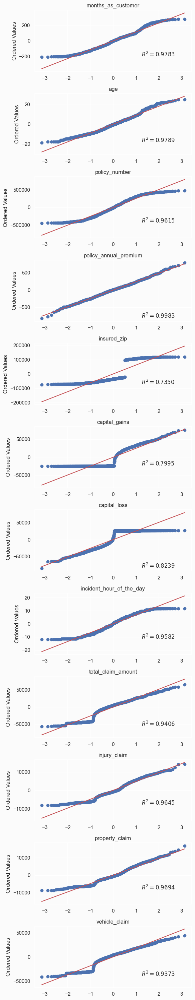

In [260]:
from scipy.stats import probplot

fig, axes = plt.subplots(12, 1, figsize=(6,30))

for i, col in enumerate(list_num_col):

    model = ols(f'{col} ~ fraud_reported', data=pd.concat([train_set[list_num_col], train_set['fraud_reported']], axis=1)).fit()

    normality_plot, stat = probplot(model.resid, plot = axes[i], rvalue = True)

    axes[i].set_title(col)
    axes[i].set_xlabel('')
    

fig.tight_layout()
plt.show()

### <a id='toc3_2_3_'></a>[<b>Equal Variance Test: Levene Test</b>](#toc0_)

- **Null Hypothesis:** Equal Variances
- **Alternative Hypothesis:** Inequal Variances

In [264]:
from scipy.stats import levene

levene_test = dict()

for col in list_num_col:

    levene_ = levene(
                        train_set[col][train_set['fraud_reported']=='Y'],
                        train_set[col][train_set['fraud_reported']=='N']
                    )
    
    levene_test.setdefault('column',[]).append(col)
    levene_test.setdefault('levene',[]).append(levene_[1])

    if levene_[1] < 0.01:
        levene_test.setdefault('result', []).append('Reject Ho')

    else:
        levene_test.setdefault('result', []).append('Failed to Reject Ho')

levene_test = pd.DataFrame(levene_test).set_index('column')
levene_test

,levene,result
column,,
months_as_customer,0.255101,Failed to Reject Ho
age,0.184850,Failed to Reject Ho
policy_number,0.983943,Failed to Reject Ho
policy_annual_premium,0.662281,Failed to Reject Ho
insured_zip,0.735818,Failed to Reject Ho
capital_gains,0.617612,Failed to Reject Ho
capital_loss,0.985661,Failed to Reject Ho
incident_hour_of_the_day,0.591711,Failed to Reject Ho
total_claim_amount,0.000008,Reject Ho


### <a id='toc3_2_4_'></a>[**Welch T-Test**](#toc0_)

        Equal Variance would perform Independence T-Test.
        Non-Equal Variance would perform Welch's Test.

-------------------------
        H0 : There's no difference mean between var1 and var2,
        H1 : There's difference mean between var1 and var2,
>**H₀ : μ₁ = μ₂** <br>

>**H₁ : μ₁ ≠ μ₂**
<br>

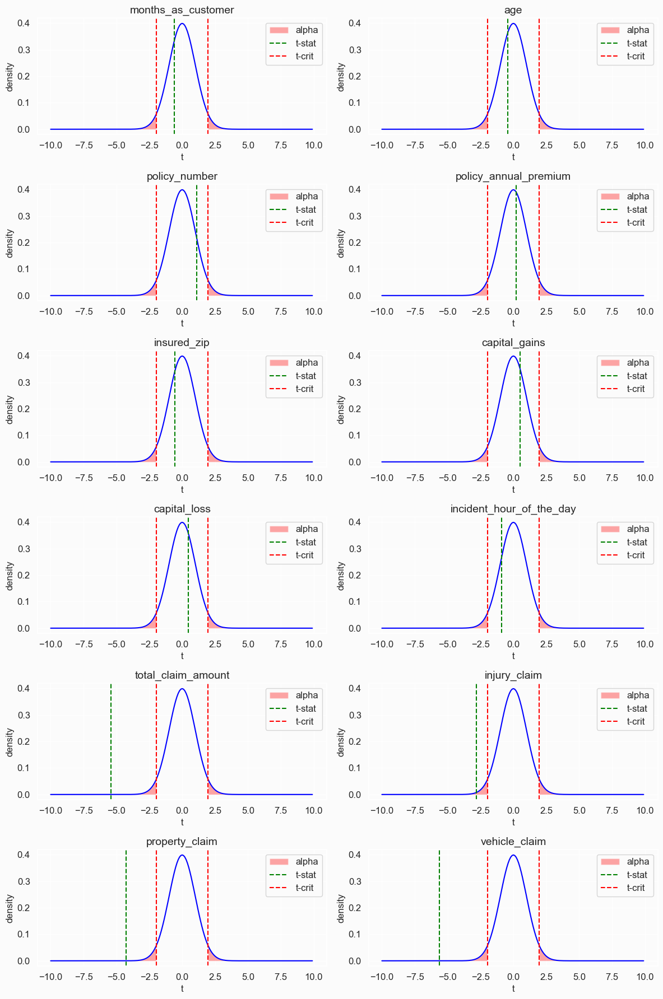

In [273]:
import scipy
from scipy.stats import ttest_ind

alpha = 0.05
fig, axes = plt.subplots(6, 2, figsize=(12, 18))  # Create subplots with 3 rows and 2 columns

welch_test = dict()

for i, ax in zip(list_num_col, axes.flatten()):
    
    lst_0 = train_set[i][train_set['fraud_reported']=='N']
    lst_1 = train_set[i][train_set['fraud_reported']=='Y']
    
    degree = lst_0.count() + lst_1.count()

    x = np.arange(-10,10,0.1)
    
    t_stat, p_value = ttest_ind(lst_0, lst_1, equal_var=False)
    t_crit = scipy.stats.t.ppf(alpha/2, degree)

    welch_test.setdefault('column', []).append(i)
    welch_test.setdefault('welch_test', []).append(round(p_value,5))

    if p_value < 0.05:
        welch_test.setdefault('result', []).append('Reject Ho')
    else:
        welch_test.setdefault('result', []).append('Failed to Reject Ho')
    
    ax.set_title(f"{i}", fontsize=14)  # Set the subplot title
    ax.plot(x, scipy.stats.norm.pdf(x, 0, 1), color='blue')  # Plot sample
    
    # plot alpha region
    x_alpha = np.arange(-10, t_crit, 0.01)
    y_alpha = scipy.stats.norm.pdf(x_alpha)
    ax.fill_between(x=x_alpha, y1=y_alpha, facecolor='red', alpha=0.35, label='alpha')
    
    # plot alpha region
    x_alpha = np.arange(-(t_crit), 10, 0.01)
    y_alpha = scipy.stats.norm.pdf(x_alpha)
    ax.fill_between(x=x_alpha, y1=y_alpha, facecolor='red', alpha=0.35)
    
    # plot z-crit and z-stats
    ax.axvline(np.round(t_stat, 4), color="green", linestyle="--", label="t-stat")
    ax.axvline(t_crit, color="red", linestyle="--", label="t-crit")
    ax.axvline(-(t_crit), color="red", linestyle="--")
    
    ax.legend(loc='best', fontsize=12)
    ax.set_xlabel("t", fontsize=12)
    ax.set_ylabel("density", fontsize=12)
    ax.tick_params(axis='both', labelsize=12)

welch_test = pd.DataFrame(welch_test).set_index('column')

plt.tight_layout()  # Adjust the spacing between subplots
plt.show()

In [274]:
welch_test

,welch_test,result
column,,
months_as_customer,0.55839,Failed to Reject Ho
age,0.67810,Failed to Reject Ho
policy_number,0.26826,Failed to Reject Ho
policy_annual_premium,0.84827,Failed to Reject Ho
insured_zip,0.56632,Failed to Reject Ho
capital_gains,0.61308,Failed to Reject Ho
capital_loss,0.64122,Failed to Reject Ho
incident_hour_of_the_day,0.36763,Failed to Reject Ho
total_claim_amount,0.00000,Reject Ho


In [345]:
welch_test_feature = welch_test[welch_test['result']=='Reject Ho'].index.to_list()
welch_test_feature

['total_claim_amount', 'injury_claim', 'property_claim', 'vehicle_claim']

Since the statistical test information regarding Two-Group Variable test to quantitative outcome show the result <br>
<br>
Besides, **Non-Equal variance** group show **Reject H0**, then these vairables is statistically significant


## <a id='toc3_3_'></a>[<b>3. Numeric vs Numeric (Multicollinearity)</b>](#toc0_)

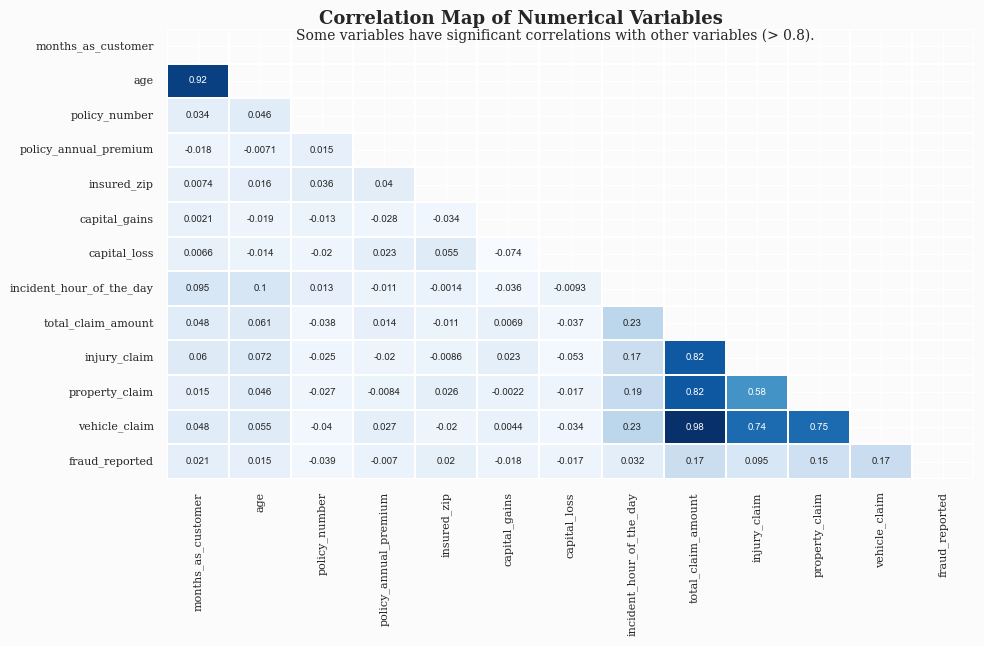

In [368]:
train_corr = train_set.copy()

train_corr.fraud_reported = train_corr.fraud_reported.map(dict(Y=1, N=0))

# -- Create Figure -- #
fig, ax = plt.subplots(figsize=(10,7))

# --- Create Correlation --- #
corr = train_corr[train_corr.select_dtypes(exclude='object').columns].corr()

# --- Create Mask --- #
mask = np.triu(np.ones_like(corr, dtype=bool))

# --- Cretea heatmap --- #
sns.heatmap(corr, annot=True, mask=mask, cmap='Blues', linewidths=0.1, cbar=False, annot_kws={"size":7})

# --- Figuration Setting --- #
yticks, ylabels = plt.yticks()
xticks, xlabels = plt.xticks()
ax.set_xticklabels(xlabels, size=8, fontfamily='serif')
ax.set_yticklabels(ylabels, size=8, fontfamily='serif')
plt.suptitle('Correlation Map of Numerical Variables', fontweight='heavy', x=0.327, y=0.96, ha='left', fontsize=13, fontfamily='serif')
plt.title('Some variables have significant correlations with other variables (> 0.8).\n', fontsize=10, x=0.16, y=0.92, fontfamily='serif', loc='left')
plt.tight_layout(rect=[0, 0.04, 1, 1.01])

In [369]:
import copy

# Create threshold of 0.8 correlation
corr_multi = corr[corr>=0.8].reset_index()

# melted to get the features with >= 0.8 value
melted_corr = pd.melt(copy.deepcopy(corr_multi), id_vars='index', var_name='column_name', value_name='correlation').sort_values(by=['correlation']).dropna()
melted_corr.columns = ['row_name', 'column_name', 'correlation']

# Drop the features that correlated each other
melted_corr = melted_corr[melted_corr['row_name'] != melted_corr['column_name']].drop_duplicates(subset='correlation')

melted_corr

,row_name,column_name,correlation
125,total_claim_amount,injury_claim,0.818404
138,total_claim_amount,property_claim,0.820697
1,age,months_as_customer,0.920221
151,total_claim_amount,vehicle_claim,0.984476


To reduce multicollinerity we can drop either **`total_claim_amount`** from the data, since **`total_claim_amount = injury_claim + property_claim + vehicle_claim`**

or the other three **(`injury_claim, property_claim, vehicle_claim`)**

## <a id='toc3_4_'></a>[<b>4. Lasso Method</b>](#toc0_)

In [291]:
# StandarScaler trains_set after Encoding
def _standard_scaler(data):
    ssc = StandardScaler()
    ssc.fit(data)
    
    train_scaled = ssc.transform(data)
    train_scaled = pd.DataFrame(train_scaled,
                                index=data.index,
                                columns=data.columns)
    
    return train_scaled

def Label_Encoder_(data):
    
    for col in data.columns.to_list():
        data[col] = LabelEncoder().fit_transform(data[col])
    
    return data

Text(0.5, 1.0, 'Feature Importance using Lasso Model')

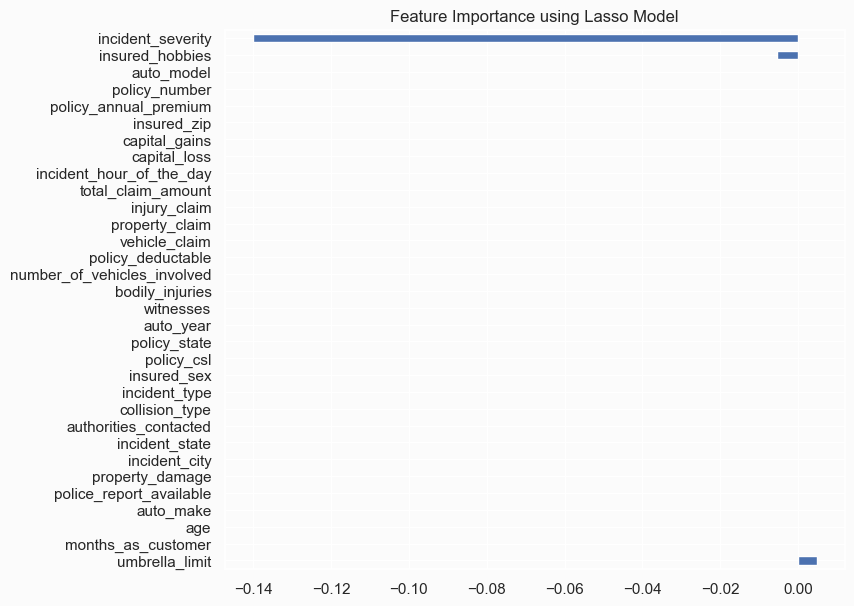

In [332]:
# ------------------------------------------
from sklearn.linear_model import LassoCV
from sklearn.preprocessing import StandardScaler

# Label Encoding

train_set_encoded = Label_Encoder_(train_set[list_cat_col])
train_set_encoded_ = pd.concat(
    [
        train_set[train_set.select_dtypes(exclude='object').columns.to_list()], 
        train_set_encoded.loc[:, ~train_set_encoded.columns.isin(['fraud_reported'])]
    ], 
    axis=1
)


train_scaled = _standard_scaler(train_set_encoded_)

train_scaled = pd.concat(
    [
        train_scaled, train_set_encoded['fraud_reported']
    ],
    axis=1
)

lasso_cv = LassoCV()

# Fit into train_set after StandardScaler
lasso_cv.fit(
    train_scaled.drop(columns='fraud_reported', axis=1),
    train_scaled['fraud_reported']
)

coef = pd.Series(lasso_cv.coef_, index = train_set[train_scaled.drop(columns='fraud_reported', axis=1).columns.to_list()].columns)

imp_coef = coef.sort_values(ascending=False)

import matplotlib

matplotlib.rcParams['figure.figsize'] = (8.0, 7.0)
imp_coef.plot(kind='barh')
plt.title('Feature Importance using Lasso Model')

In [333]:
lasso_cv.alpha_

0.025067137872476657

## <a id='toc3_5_'></a>[<b>5. XGBoost Method</b>](#toc0_)

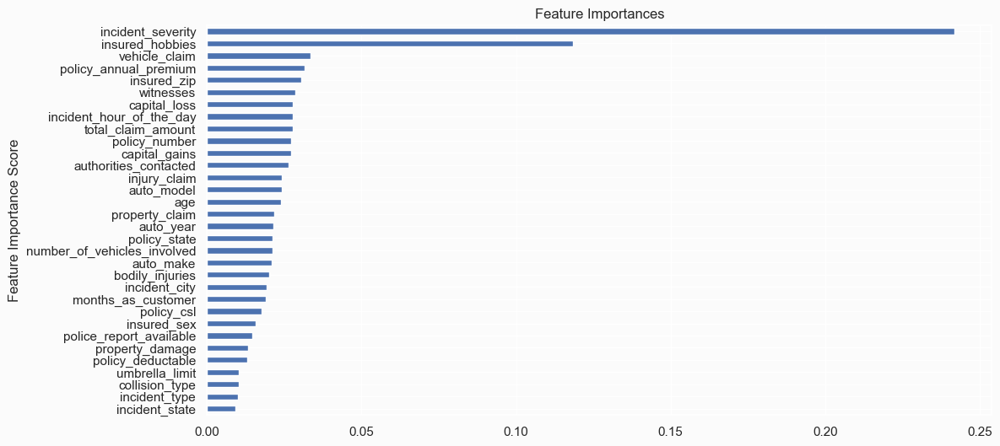

In [315]:
from xgboost import XGBClassifier

xgb = XGBClassifier()

xgb.fit(
    train_scaled.drop(columns='fraud_reported', axis=1),
    train_scaled['fraud_reported']
)

fig, ax = plt.subplots(figsize=(12,6))

feat_imp = pd.Series(

    xgb.feature_importances_, 
    train_scaled.drop(columns='fraud_reported', axis=1).columns.to_list()

).sort_values(ascending=True)

feat_imp.plot(kind='barh', title='Feature Importances')

plt.ylabel('Feature Importance Score')
plt.show()

## <a id='toc3_6_'></a>[<b>6. Random Forest</b>](#toc0_)

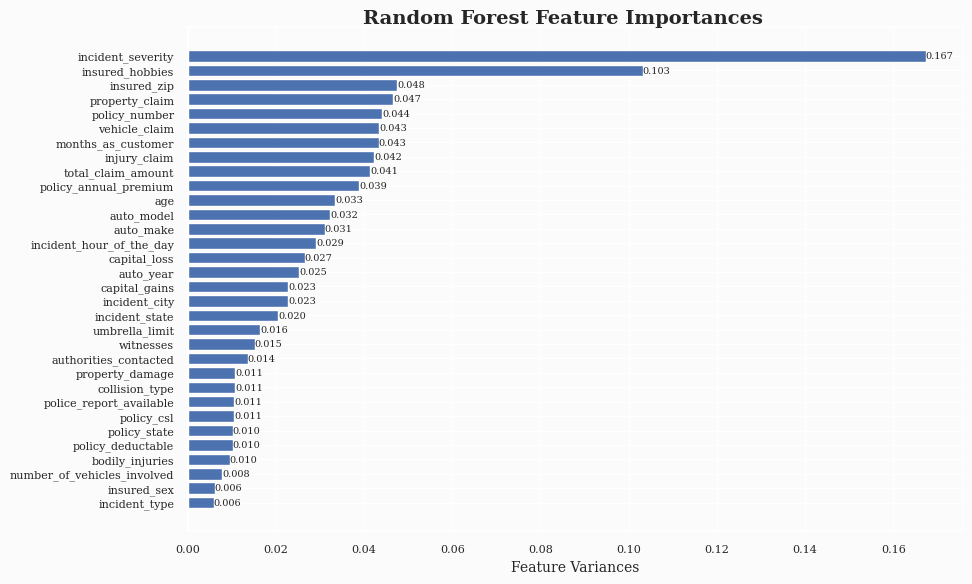

In [319]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier()

rf.fit(
    train_scaled.drop(columns='fraud_reported',axis=1), 
    train_scaled['fraud_reported']
)

sorted_index = rf.feature_importances_.argsort()
fig, ax = plt.subplots(figsize=(10,6))

fig.suptitle("Random Forest Feature Importances", fontsize=14, fontname='serif', fontweight='bold')
fig.subplots_adjust(top=0.95)

rf_importances = rf.feature_importances_[sorted_index]
rf_feature_names = train_scaled.drop(columns='fraud_reported',axis=1).columns[sorted_index]

ax.barh(rf_feature_names, rf_importances)

ax.set_xlabel("Feature Variances", fontsize=10, fontname='serif')
ax.set_xticklabels(ax.get_xticklabels(), fontname='serif', fontsize=8)
ax.set_yticklabels(rf_feature_names, fontname='serif', fontsize=8)

# Add labels to the bars
for i in range(len(rf_importances)):
    ax.text(rf_importances[i], i, f"{rf_importances[i]:.3f}", ha='left', va='center', fontsize=7, fontname='serif')


plt.show()

# <a id='toc4_'></a>[<b>Handling Imbalance Data</b>](#toc0_)
------

balancing data using <b>SMOTENC</b> and <b>Oversampling</b>, since using <b>Undersampling</b> can significantly reduce our data

In [440]:
x_train = util.pickle_load(config_data["train_set_path"][0])
y_train = util.pickle_load(config_data["train_set_path"][1])

x_valid = util.pickle_load(config_data["valid_set_path"][0])
y_valid = util.pickle_load(config_data["valid_set_path"][1])

x_test = util.pickle_load(config_data["test_set_path"][0])
y_test = util.pickle_load(config_data["test_set_path"][1])

In [444]:
valid_set = pd.concat([x_valid, y_valid], axis=1)
test_set = pd.concat([x_test, y_test], axis=1)

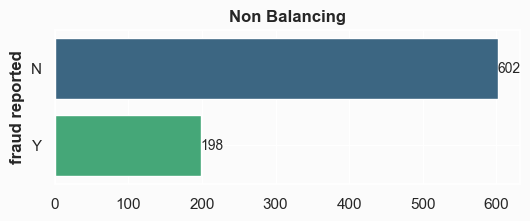

In [374]:
fig, ax = plt.subplots(figsize=(6,2))

ax = sns.countplot(data=train_set,
            y='fraud_reported',
            palette='viridis',
            ax=ax)

ax.bar_label(ax.containers[0], fontsize=10)
ax.grid(visible=True)
ax.set_ylabel('')
ax.set_title('Non Balancing', fontweight='bold')
ax.set_ylabel('fraud reported', fontsize=12, fontweight='bold')
ax.set_xlabel('')

plt.show()

## <a id='toc4_1_'></a>[<b>Balancing</b>](#toc0_)

In [376]:
# Using SMOTENC and Oversampling
def balancing(x_data, y_data):
    # --- numerical predictor on config--- #
    x_set_num = x_data[config_data['int32_col']]

    # --- categorical predictor on config --- #
    x_set_cat = x_data[config_data['object_predictor']]

    # --- New predictor --- #
    x_train_new = pd.concat([x_set_num, x_set_cat], axis=1)

    # --- SMOTENC --- #
    sm = SMOTENC(random_state=42, categorical_features = list(range(len(x_set_num.columns),32)))
    x_smote, y_smote = sm.fit_resample(x_train_new, y_data)

    # --- Oversampling --- #
    x_over, y_over = RandomOverSampler(random_state=42).fit_resample(x_data, y_data)

    # --- Concate Predictor and Label --- #
    train_set_smote = pd.concat([x_smote, y_smote], axis = 1)
    train_set_over = pd.concat([x_over, y_over], axis = 1)

    return train_set_smote, train_set_over

In [442]:
train_set_smote, train_set_over = balancing(x_train, y_train)
valid_set_smote, valid_set_over = balancing(x_valid, y_valid)
test_set_smote, test_set_over = balancing(x_test, y_test)

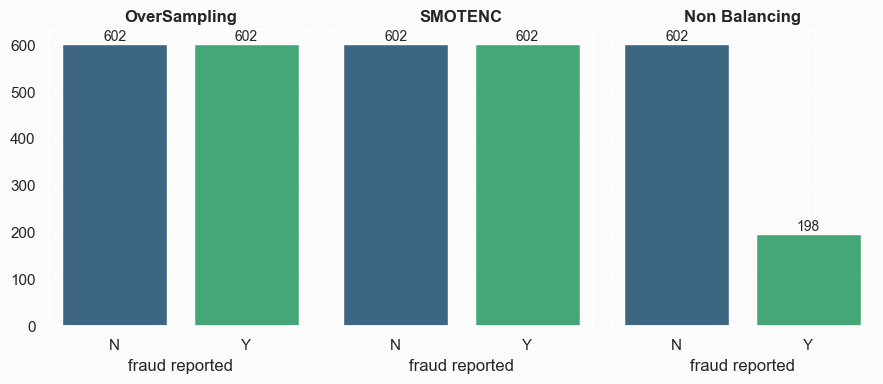

In [381]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(9,4), sharey=True)

ax1 = sns.barplot(data=pd.DataFrame(train_set_over.fraud_reported.value_counts()).reset_index(),
            x='index',
            y='fraud_reported',
            palette='viridis',
            ax=ax1)

ax1.bar_label(ax1.containers[0], fontsize=10)
ax1.grid(visible=True)
ax1.set_ylabel('')
ax1.set_title('OverSampling', fontsize=12, fontweight='bold')
ax1.set_xlabel('fraud reported', fontsize=12)

ax2 = sns.barplot(data=pd.DataFrame(train_set_smote.fraud_reported.value_counts()).reset_index(),
            x='index',
            y='fraud_reported',
            palette='viridis',
            ax=ax2)

ax2.bar_label(ax2.containers[0], fontsize=10)
ax2.grid(visible=True)
ax2.set_ylabel('')
ax2.set_title('SMOTENC', fontsize=12, fontweight='bold')
ax2.set_xlabel('fraud reported', fontsize=12)

ax3 = sns.barplot(data=pd.DataFrame(y_train.value_counts()).reset_index(),
            x='index',
            y='fraud_reported',
            palette='viridis',
            ax=ax3)

ax3.bar_label(ax3.containers[0], fontsize=10)
ax3.grid(visible=True)
ax3.set_ylabel('')
ax3.set_title('Non Balancing', fontweight='bold')
ax3.set_xlabel('fraud reported', fontsize=12)

plt.tight_layout()
plt.show()

## <a id='toc4_2_'></a>[<b> Selected Features</b>](#toc0_)

In [382]:
## Feature from chi square test (categoric) and feature from welch's test (numeric)
selected_features = chi_score_feature + welch_test_feature

## Drop total_claim_amount based on pearson correlation collinearity
selected_features.remove('total_claim_amount')

## Append Fraud_reported as target variable
selected_features.append('fraud_reported')


In [383]:
train_set_eda = train_set.copy()[selected_features]

In [384]:
train_set_eda.head()

,insured_hobbies,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,property_damage,injury_claim,property_claim,vehicle_claim,fraud_reported
887,exercise,Parked Car,UNKNOWN,Minor Damage,UNKNOWN,VA,NO,640,640,5120,N
317,camping,Multi-vehicle Collision,Side Collision,Total Loss,Ambulance,VA,YES,5360,10720,48240,N
796,reading,Single Vehicle Collision,Rear Collision,Major Damage,Ambulance,NY,UNKNOWN,16860,8430,67440,Y
425,basketball,Multi-vehicle Collision,Side Collision,Major Damage,Police,WV,UNKNOWN,6080,12160,48640,Y
991,basketball,Single Vehicle Collision,Rear Collision,Total Loss,Other,WV,NO,0,5220,41760,N


In [396]:
train_set_smote_eda = train_set_smote.copy()[selected_features]
train_set_over_eda = train_set_over.copy()[selected_features]

In [397]:
train_set_smote_eda.head(10)

,insured_hobbies,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,property_damage,injury_claim,property_claim,vehicle_claim,fraud_reported
0,exercise,Parked Car,UNKNOWN,Minor Damage,UNKNOWN,VA,NO,640,640,5120,N
1,camping,Multi-vehicle Collision,Side Collision,Total Loss,Ambulance,VA,YES,5360,10720,48240,N
2,reading,Single Vehicle Collision,Rear Collision,Major Damage,Ambulance,NY,UNKNOWN,16860,8430,67440,Y
3,basketball,Multi-vehicle Collision,Side Collision,Major Damage,Police,WV,UNKNOWN,6080,12160,48640,Y
4,basketball,Single Vehicle Collision,Rear Collision,Total Loss,Other,WV,NO,0,5220,41760,N
5,skydiving,Multi-vehicle Collision,Rear Collision,Minor Damage,Ambulance,WV,NO,5940,2970,23760,N
6,golf,Multi-vehicle Collision,Rear Collision,Major Damage,Fire,SC,NO,12100,6050,42350,N
7,polo,Parked Car,UNKNOWN,Minor Damage,Police,SC,NO,620,620,4340,Y
8,chess,Multi-vehicle Collision,Rear Collision,Total Loss,Ambulance,NC,NO,4270,4270,34160,Y
9,camping,Parked Car,UNKNOWN,Trivial Damage,UNKNOWN,SC,UNKNOWN,630,630,5040,N


In [449]:
def select_features(data_1, data_2, data_3):
    data_1 = data_1[selected_features]
    data_2 = data_2[selected_features] 
    data_3 = data_3[selected_features]

    return data_1, data_2, data_3

In [450]:
valid_set_eda, valid_set_smote_eda, valid_set_over_eda = select_features(valid_set, valid_set_smote, valid_set_over)
test_set_eda, test_set_smote_eda, test_set_over_eda = select_features(test_set, test_set_smote, test_set_over)

In [455]:
valid_set_eda

,insured_hobbies,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,property_damage,injury_claim,property_claim,vehicle_claim,fraud_reported
499,camping,Single Vehicle Collision,Side Collision,Minor Damage,Other,NC,YES,13340,6670,53360,N
888,chess,Single Vehicle Collision,Rear Collision,Major Damage,Fire,SC,YES,12120,6060,42420,N
151,polo,Multi-vehicle Collision,Rear Collision,Major Damage,Fire,NC,UNKNOWN,10680,5340,32040,N
731,polo,Single Vehicle Collision,Side Collision,Major Damage,Ambulance,VA,UNKNOWN,6060,6060,54540,N
673,golf,Single Vehicle Collision,Rear Collision,Major Damage,Police,SC,UNKNOWN,3720,3720,26040,N
...,...,...,...,...,...,...,...,...,...,...,...
694,reading,Multi-vehicle Collision,Rear Collision,Total Loss,Other,WV,UNKNOWN,0,11400,45600,N
988,dancing,Single Vehicle Collision,Rear Collision,Minor Damage,Fire,NY,YES,12140,6070,42490,N
819,camping,Single Vehicle Collision,Side Collision,Minor Damage,Other,SC,YES,5590,11180,44720,N
228,kayaking,Multi-vehicle Collision,Front Collision,Total Loss,Fire,WV,YES,6560,6560,45920,N


--------

## <a id='toc4_3_'></a>[Check Map Correlations using PPS](#toc0_)

In [387]:
import ppscore as pps

In [390]:
pps_score = pps.matrix(train_set_eda).set_index('x')

pps_score[(pps_score['y']=='fraud_reported') & (pps_score['ppscore']>0.01)]

,y,ppscore,case,is_valid_score,metric,baseline_score,model_score,model
x,,,,,,,,
insured_hobbies,fraud_reported,0.362860,classification,True,weighted F1,0.646227,0.774597,DecisionTreeClassifier()
incident_severity,fraud_reported,0.461061,classification,True,weighted F1,0.646227,0.809338,DecisionTreeClassifier()
property_claim,fraud_reported,0.101242,classification,True,weighted F1,0.646227,0.682044,DecisionTreeClassifier()
vehicle_claim,fraud_reported,0.021622,classification,True,weighted F1,0.646227,0.653876,DecisionTreeClassifier()
fraud_reported,fraud_reported,1.000000,predict_itself,True,None,0.000000,1.000000,None


## <a id='toc4_4_'></a>[Handling Outliers data](#toc0_)

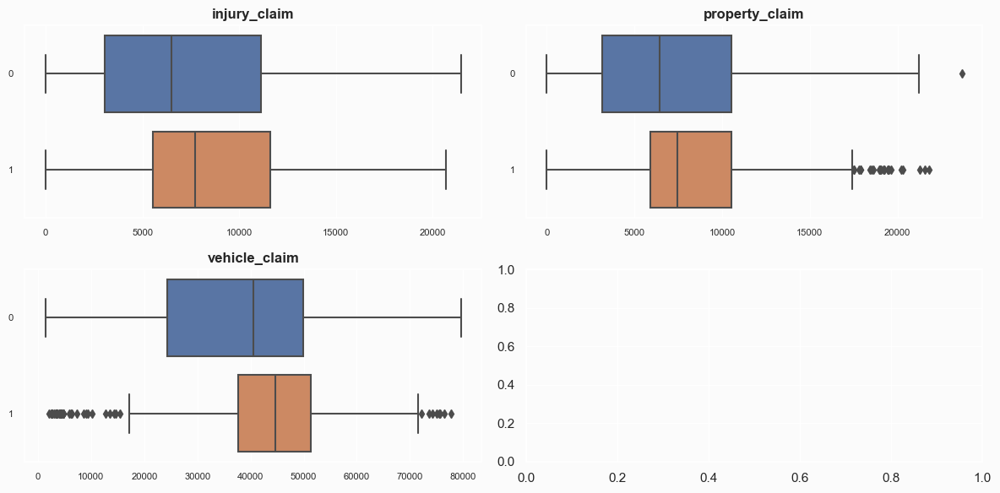

In [417]:
list_num_col_smote_eda = []

for col in train_set_smote_eda.columns:
    if (train_set_smote_eda[col].dtype == 'int32'):
        list_num_col_smote_eda.append(col)

fig, axs = plt.subplots(2, 2, figsize=(12,6))
count = 0

train_set_box = train_set_smote_eda.copy()
train_set_box.fraud_reported = train_set_box.fraud_reported.map(dict(Y=1,N=0))

for i in range(2):
    for j in range(2):

        if count >= len(list_num_col_smote_eda):
            break

        sns.boxplot(data = train_set_box, x=list_num_col_smote_eda[count], y='fraud_reported', ax=axs[i, j], orient='h')

        axs[i, j].tick_params(axis='x', labelsize=8)
        axs[i, j].tick_params(axis='y', labelsize=8)

        axs[i, j].set_xlabel('')
        axs[i, j].set_ylabel('')
        axs[i, j].set_title(list_num_col_smote_eda[count], fontweight='bold')

        count += 1


plt.tight_layout()
plt.show()

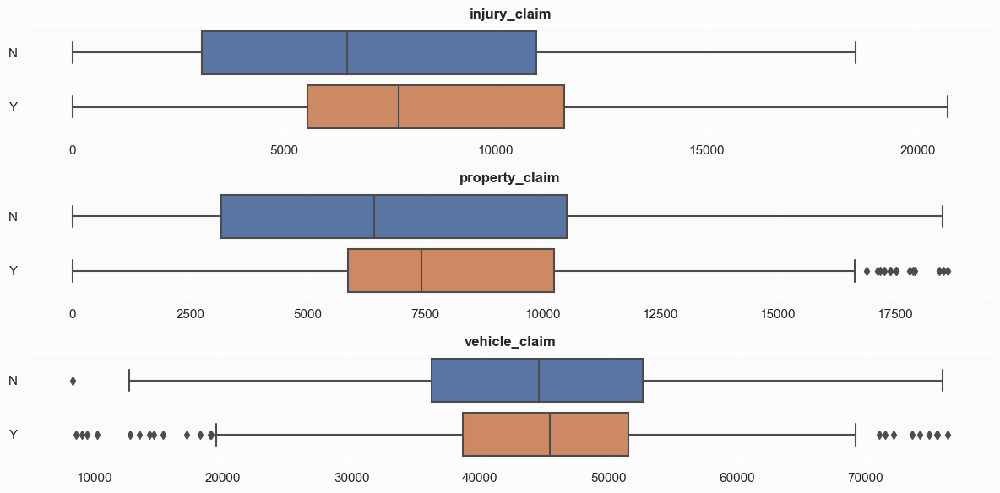

In [425]:
fig, axs = plt.subplots(3, 1, figsize=(12,6))
count = 0

for i, col in enumerate(list_num_col_smote_eda):

    if count >= len(list_num_col_smote_eda):
            break

    q1 = train_set_smote_eda[col].quantile(0.25)
    q3 = train_set_smote_eda[col].quantile(0.75)
    iqr = q3-q1

    train_set_smote_annual = train_set_smote_eda[~((train_set_smote_eda[col] < (q1 - 1.5*iqr)) |
                                            (train_set_smote_eda[col] > (q3 + 1.5*iqr)))].copy()

    sns.boxplot(data=train_set_smote_annual, x=col, ax=axs[i], y='fraud_reported')

    axs[i].set_xlabel('')
    axs[i].set_ylabel('')
    axs[i].set_title(list_num_col_smote_eda[count], fontweight='bold')

    count += 1

fig.tight_layout()
plt.show()

## <a id='toc4_5_'></a>[Pairplot](#toc0_)

In [408]:
train_set_pair_plot = train_set_eda.copy()

train_set_pair_plot.fraud_reported = train_set_pair_plot.fraud_reported.map(dict(Y=1, N=0))

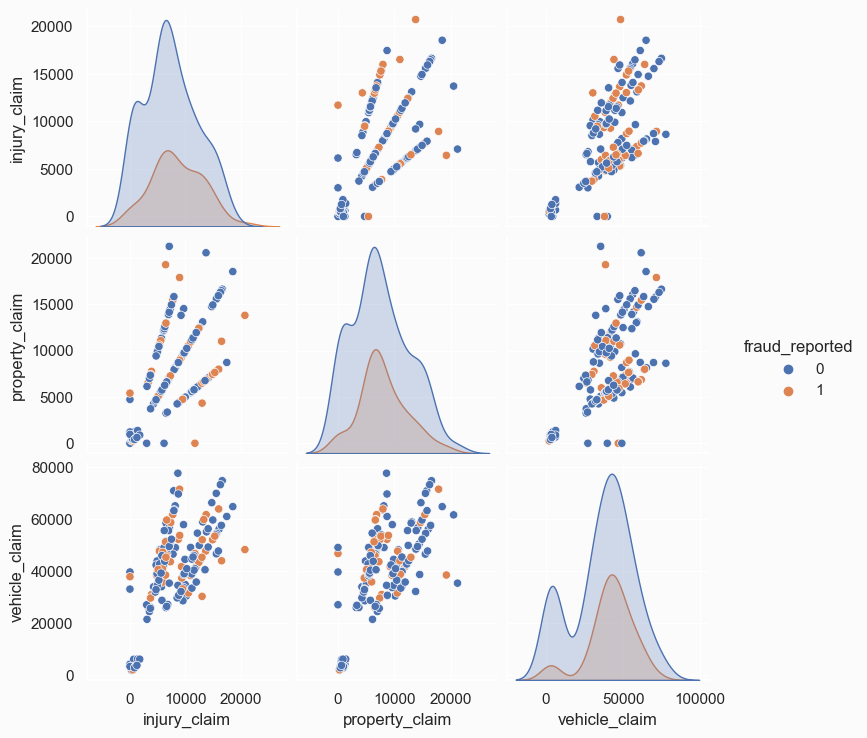

In [409]:
sns.pairplot(
    train_set_eda[
        train_set_pair_plot.select_dtypes(exclude='object').columns
    ].sample(200),
    hue = config_data['label']
)

# Store Data to Directory

In [437]:
config_data = util.load_config()

In [459]:
def split_data(data):
    x = data.drop(columns='fraud_reported', axis=1)
    y = data.fraud_reported

    return x, y


def dict_data(data_1, data_2, data_3):

    x_1, y_1 = split_data(data_1)
    x_2, y_2 = split_data(data_2)
    x_3, y_3 = split_data(data_3)

    x_ = {
        "nonbalance" : x_1,
        "smote" : x_2,
        "oversampling" : x_3
    }

    y_ = {
        "nonbalance" : y_1,
        "smote" : y_2,
        "oversampling" : y_3
    }

    return x_, y_

In [461]:
x_train_eda, y_train_eda = dict_data(train_set_eda, train_set_smote_eda, train_set_over_eda)
x_valid_eda, y_valid_eda = dict_data(valid_set_eda, valid_set_smote_eda, valid_set_over_eda)
x_test_eda, y_test_eda = dict_data(test_set_eda, test_set_smote_eda, test_set_over_eda)

In [465]:
util.pickle_dump(x_train_eda, config_data['train_set_eda'][0])
util.pickle_dump(y_train_eda, config_data['train_set_eda'][1])

util.pickle_dump(x_valid_eda, config_data['valid_set_eda'][0])
util.pickle_dump(y_valid_eda, config_data['valid_set_eda'][1])

util.pickle_dump(x_test_eda, config_data['test_set_eda'][0])
util.pickle_dump(y_test_eda, config_data['test_set_eda'][1])